# Swiggy Delivery Challenge - Avoiding Rejects
<p align = center>
<img src = "https://upload.wikimedia.org/wikipedia/en/thumb/1/12/Swiggy_logo.svg/1280px-Swiggy_logo.svg.png" height = 80>
</p>

## Case Study
Swiggy has a bold vision to elevate the quality of life of urban consumers by offering unparalleled convenience. At the heart of this vision is solving the hyperlocal delivery challenge of 

***“ Assigning the right delivery partners to the right set of orders at the right time”***

This is one of those problems that is positioned at the cusp of marrying the state of the art methods in Artificial Intelligence and Operations Research in large-scale near-real-time applications. 



Our delivery partners have the option to reject an order, if he/she wishes to. However, rejection of an order increases the delivery time for the customer, hence we want to avoid rejects.  

Here are two sample datasets:

Assignment: Each row corresponds to an order assignment to the delivery partner.

|**Column name**|**Description**|
| :- | :- |
|ORDER\_ID|Unique Identifier for the ORDER|
|DE\_ID|Unique Identifier for the DE|
|ASSIGNMENT\_START\_TIME|Start Time of the Assignment|
|ASSIGNMENT\_END\_TIME|End Time of the Assignment|
|reject\_ind|Whether this assignment was rejected|
|reject\_type|Reject Type of this Assignment|
|PLACED\_TIME|Order Placed Time|
|DELIVERED\_TIME|Order Delivered Time|
|LASTMILE\_DISTANCE|Distance to travel in Last Mile (from Restaurant to Customer)|
|FIRSTMILE\_DISTANCE|Distance to travel in First Mile (from DE Assignment Location to Restaurant)|
|LAST\_MILE\_TIME\_PREDICTED|Time prediction for last mile|
|PAYOUT\_MADE\_TO\_DE|Actual payout made to DE for this order|
|NUM\_PING\_COUNT\_LAST10MIN|# of pings received from DE device in last 10 minutes|
|LAST\_PING\_TIME\_LAST10MIN|time of last ping received from DE device (within last 10 minutes)|
|CUSTOMER\_ZONE|Zone ID for the customer|
|CUSTOMER\_LAT|Coordinates of the customer|
|CUSTOMER\_LAT|Coordinates of the customer|




Delivery Partners: Each row corresponds to a delivery partner.


|**Column name**|**Description**|
| :- | :- |
|DE\_ID|Unique Identifier for the DE|
|SHIFT\_END\_TIME|Shift end time for DE (in HH:MM)|
|DE\_HOME\_LAT|Home Location coordinate for the DE|
|DE\_HOME\_LNG|Home Location coordinate for the DE|
|DE\_JOINING\_DATE|Joining date of the DE|
|DE\_ZONE\_ID|Zone ID for the DE|

These two datasets are attached in the email.

**Additional details:** 

- Every 2 minutes, all the non-assigned orders are input to the assignment module. For each order, a set of DEs are evaluated, and the order is finally assigned one of these DEs.
- Delivery partners are allowed one reject per day, beyond which they are penalized.
- No payout is made to DE, if he rejects an order
- Every instance of a DE reject, is stored in the production tables, as a unique entry.


Delivering best customer experience is of supreme importance to Swiggy.

As a data scientist, solve the following challenges.

1. The first part of any data science problem is understanding the size, impact and cause of the problem (DE rejection in this case). With that context, can you do an exploratory data analysis?
1. Can you apply a machine learning algorithm on this dataset, to solve the problem? (Hint - The first run of model training might give you weird results)  
1. Can you think about where and how the model should be used? Do you see any deployment challenges with the same? How do you overcome these challenges?

Requirements :

- Please submit a notebook of working code with results that you would be walking us through during the Technical depth round. 
- You are free to use slides to present the results as well along with code walkthrough.

# Load the libraries

In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.preprocessing import scale 
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report
from sklearn.metrics import roc_auc_score,roc_curve
import statsmodels.formula.api as smf
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
from warnings import filterwarnings
filterwarnings('ignore')

# Load the datasets

In [2]:
from google.colab import files
uploaded = files.upload()

Saving Assignment_Data.csv to Assignment_Data.csv
Saving Delivery_Partners_Data.csv to Delivery_Partners_Data.csv


In [11]:
data_1 = pd.read_csv('Assignment_Data.csv')
data_1.head()

,ORDER_ID,DE_ID,ASSIGNMENT_START_TIME,ASSIGNMENT_END_TIME,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,LAST_PING_TIME_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG
0,2745,180976,2021-02-13 03:08:24.000,2021-02-13 03:38:26.000,0,NaN,2021-02-13 03:01:11.686,2021-02-13 03:43:26.000,320.9,320.0,314.0,1810.0,63,2021-02-13 03:07:34.000,373.0,37.377569,72.832560
1,9462,280243,2021-02-14 05:06:40.000,2021-02-14 05:31:04.000,0,NaN,2021-02-14 04:54:25.832,2021-02-14 05:36:04.000,516.8,342.5,451.0,3210.0,27,2021-02-14 05:06:40.000,373.0,37.380613,72.796909
2,14071,339813,2021-02-15 02:22:40.000,2021-02-15 02:44:02.000,0,NaN,2021-02-15 02:01:17.864,2021-02-15 02:49:02.000,459.5,418.7,443.0,2910.0,57,2021-02-15 02:22:35.000,373.0,37.372032,72.805871
3,14442,1315348,2021-02-15 03:01:25.000,2021-02-15 03:15:02.000,0,NaN,2021-02-15 02:43:41.129,2021-02-15 03:20:02.000,376.4,332.9,367.3,3210.0,41,2021-02-15 03:00:28.000,373.0,37.371380,72.819992
4,14515,1186729,2021-02-15 03:12:24.000,2021-02-15 03:50:24.000,0,NaN,2021-02-15 02:48:17.074,2021-02-15 03:55:24.000,414.5,334.1,413.2,3210.0,13,2021-02-15 03:12:09.000,373.0,37.369925,72.826764


In [12]:
data_2 = pd.read_csv('Delivery_Partners_Data.csv')
data_2.head()

,DE_ID,SHIFT_END_TIME,DE_HOME_LAT,DE_HOME_LNG,DE_JOINING_DATE,DE_ZONE_ID
0,141533,06:42,37.390427,72.849424,2019-09-20,372
1,235942,08:42,37.372289,72.885341,2020-03-15,372
2,973234,06:42,37.410268,72.853610,2018-12-21,375
3,973473,05:42,37.397067,72.872533,2018-12-21,624
4,1016546,06:42,37.425545,72.895137,2019-01-11,668


# Exploratory Data Analysis

## Assignment Data

In [13]:
data_1.describe()

,ORDER_ID,DE_ID,reject_ind,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG
count,132394.000000,1.323940e+05,132394.000000,132384.000000,132238.000000,132394.000000,132391.000000,132394.000000,113853.000000,132394.000000,132394.000000
mean,62266.261303,6.156389e+05,0.060788,432.864177,364.857121,403.579538,2764.807124,24.165408,489.926537,37.389104,72.859044
std,36083.677703,3.801389e+05,0.238942,82.305359,40.211260,53.905507,1277.496520,17.674050,171.226181,0.023136,0.032406
min,1.000000,2.200000e+02,0.000000,320.000000,320.000000,250.000000,0.000000,1.000000,372.000000,37.271775,72.703223
25%,30948.250000,3.338200e+05,0.000000,373.400000,327.500000,361.500000,2110.000000,11.000000,373.000000,37.371754,72.837974
50%,62166.500000,3.862560e+05,0.000000,415.400000,356.600000,399.500000,2610.000000,20.000000,375.000000,37.387886,72.856902
75%,93589.750000,9.462630e+05,0.000000,473.900000,392.600000,440.800000,3260.000000,32.000000,624.000000,37.407065,72.878175
max,124798.000000,1.376302e+06,1.000000,1044.500000,743.000000,642.300000,10410.000000,120.000000,841.000000,37.483737,73.029503


In [14]:
data_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 132394 entries, 0 to 132393
Data columns (total 17 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   ORDER_ID                  132394 non-null  int64  
 1   DE_ID                     132394 non-null  int64  
 2   ASSIGNMENT_START_TIME     132394 non-null  object 
 3   ASSIGNMENT_END_TIME       132394 non-null  object 
 4   reject_ind                132394 non-null  int64  
 5   reject_type               8048 non-null    object 
 6   PLACED_TIME               132394 non-null  object 
 7   DELIVERED_TIME            131782 non-null  object 
 8   LASTMILE_DISTANCE         132384 non-null  float64
 9   FIRSTMILE_DISTANCE        132238 non-null  float64
 10  LAST_MILE_TIME_PREDICTED  132394 non-null  float64
 11  PAYOUT_MADE_TO_DE         132391 non-null  float64
 12  NUM_PING_COUNT_LAST10MIN  132394 non-null  int64  
 13  LAST_PING_TIME_LAST10MIN  132394 non-null  o

In [15]:
data_1.columns

Index(['ORDER_ID', 'DE_ID', 'ASSIGNMENT_START_TIME', 'ASSIGNMENT_END_TIME',
       'reject_ind', 'reject_type', 'PLACED_TIME', 'DELIVERED_TIME',
       'LASTMILE_DISTANCE', 'FIRSTMILE_DISTANCE', 'LAST_MILE_TIME_PREDICTED',
       'PAYOUT_MADE_TO_DE', 'NUM_PING_COUNT_LAST10MIN',
       'LAST_PING_TIME_LAST10MIN', 'CUSTOMER_ZONE', 'CUSTOMER_LAT',
       'CUSTOMER_LNG'],
      dtype='object')

In [16]:
data_1.dtypes

ORDER_ID                      int64
DE_ID                         int64
ASSIGNMENT_START_TIME        object
ASSIGNMENT_END_TIME          object
reject_ind                    int64
reject_type                  object
PLACED_TIME                  object
DELIVERED_TIME               object
LASTMILE_DISTANCE           float64
FIRSTMILE_DISTANCE          float64
LAST_MILE_TIME_PREDICTED    float64
PAYOUT_MADE_TO_DE           float64
NUM_PING_COUNT_LAST10MIN      int64
LAST_PING_TIME_LAST10MIN     object
CUSTOMER_ZONE               float64
CUSTOMER_LAT                float64
CUSTOMER_LNG                float64
dtype: object

In [17]:
sns.pairplot(data_1,height=10)

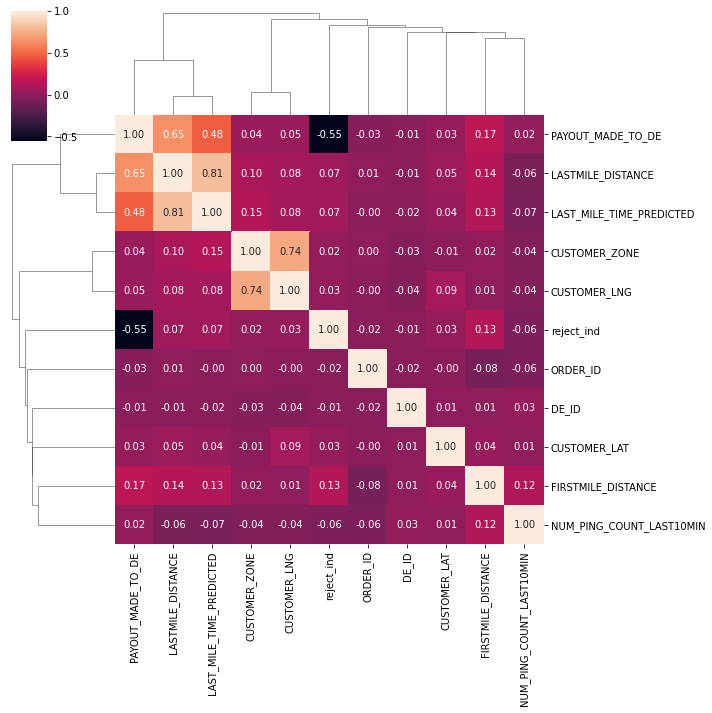

In [18]:
corr_data=data_1.corr()
sns.clustermap(corr_data,annot=True,fmt='.2f')

## Delivery Partners Data

Text(0, 0.5, 'DE_HOME_LNG')

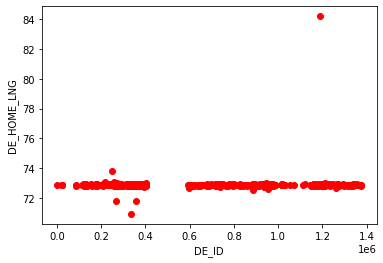

In [19]:
plt.scatter(data_2['DE_ID'],data_2['DE_HOME_LNG'],marker='o',color='r')
plt.xlabel("DE_ID")
plt.ylabel("DE_HOME_LNG")

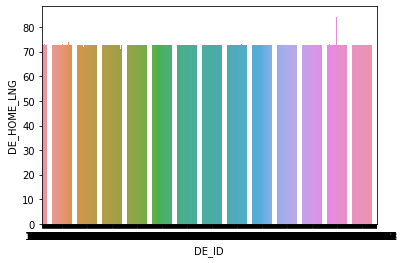

In [20]:
sns.barplot(data_2['DE_ID'],data_2['DE_HOME_LNG'])

Text(0, 0.5, 'DE_HOME_LAT')

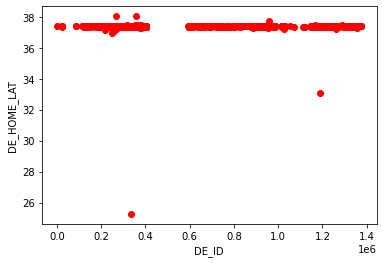

In [21]:
plt.scatter(data_2['DE_ID'],data_2['DE_HOME_LAT'],marker='o',color='r')
plt.xlabel("DE_ID")
plt.ylabel("DE_HOME_LAT")

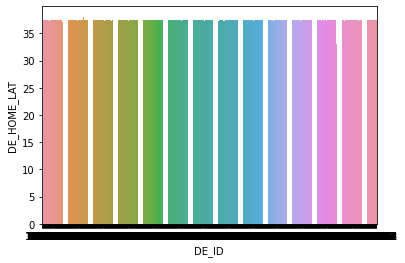

In [22]:
sns.barplot(data_2['DE_ID'],data_2['DE_HOME_LAT'])

Text(0, 0.5, 'DE_ZONE_ID')

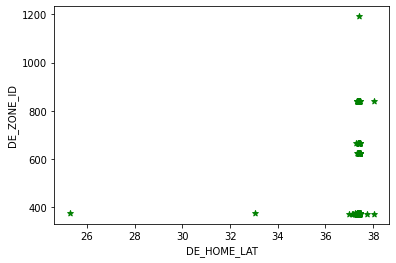

In [23]:
plt.scatter(data_2['DE_HOME_LAT'],data_2['DE_ZONE_ID'],marker='*',color='g')
plt.xlabel("DE_HOME_LAT")
plt.ylabel("DE_ZONE_ID")

Text(0, 0.5, 'DE_ZONE_ID')

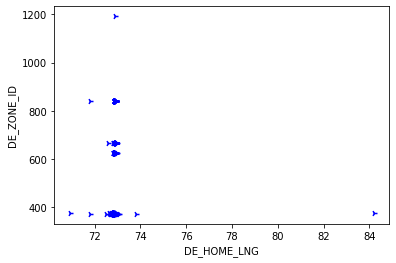

In [24]:
plt.scatter(data_2['DE_HOME_LNG'],data_2['DE_ZONE_ID'],marker='4',color='b')
plt.xlabel("DE_HOME_LNG")
plt.ylabel("DE_ZONE_ID")

Text(0.5, 0, 'DE_ZONE_ID')

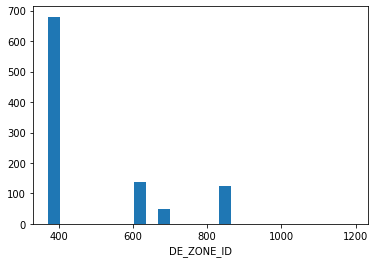

In [25]:
plt.hist(data_2['DE_ZONE_ID'],bins=25)
plt.xlabel("DE_ZONE_ID")

In [26]:
data_2['DE_JOINING_DATE'] = pd.to_datetime(data_2['DE_JOINING_DATE'])
data_2.head()

,DE_ID,SHIFT_END_TIME,DE_HOME_LAT,DE_HOME_LNG,DE_JOINING_DATE,DE_ZONE_ID
0,141533,06:42,37.390427,72.849424,2019-09-20,372
1,235942,08:42,37.372289,72.885341,2020-03-15,372
2,973234,06:42,37.410268,72.853610,2018-12-21,375
3,973473,05:42,37.397067,72.872533,2018-12-21,624
4,1016546,06:42,37.425545,72.895137,2019-01-11,668


Text(0, 0.5, 'DE_HOME_LAT')

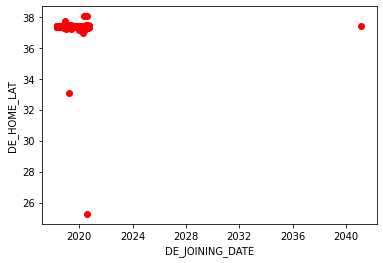

In [27]:
plt.scatter(data_2['DE_JOINING_DATE'],data_2['DE_HOME_LAT'],marker='o',color='r')
plt.xlabel("DE_JOINING_DATE")
plt.ylabel("DE_HOME_LAT")

Text(0, 0.5, 'DE_HOME_LNG')

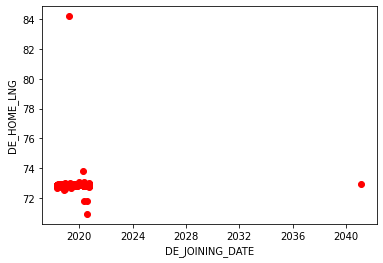

In [28]:
plt.scatter(data_2['DE_JOINING_DATE'],data_2['DE_HOME_LNG'],marker='o',color='r')
plt.xlabel("DE_JOINING_DATE")
plt.ylabel("DE_HOME_LNG")

Text(0, 0.5, 'DE_HOME_LAT')

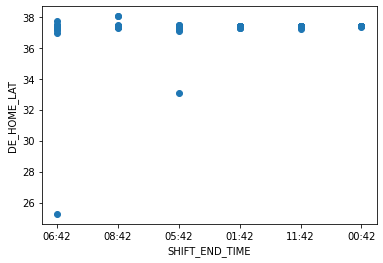

In [29]:
plt.scatter(data_2['SHIFT_END_TIME'],data_2['DE_HOME_LAT'],marker='o')
plt.xlabel("SHIFT_END_TIME")
plt.ylabel("DE_HOME_LAT")

Text(0, 0.5, 'DE_HOME_LNG')

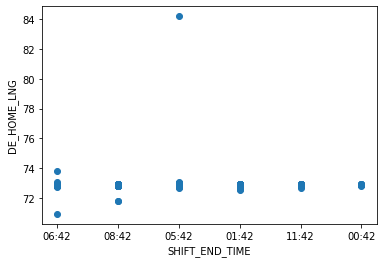

In [30]:
plt.scatter(data_2['SHIFT_END_TIME'],data_2['DE_HOME_LNG'],marker = 'o')
plt.xlabel("SHIFT_END_TIME")
plt.ylabel("DE_HOME_LNG")

Text(0, 0.5, 'SHIFT_END_TIME')

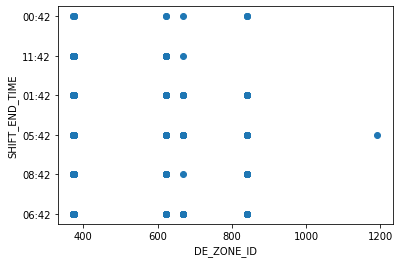

In [31]:
plt.scatter(data_2['DE_ZONE_ID'],data_2['SHIFT_END_TIME'],marker='o')
plt.xlabel("DE_ZONE_ID")
plt.ylabel("SHIFT_END_TIME")

Text(0.5, 0, 'SHIFT_END_TIME')

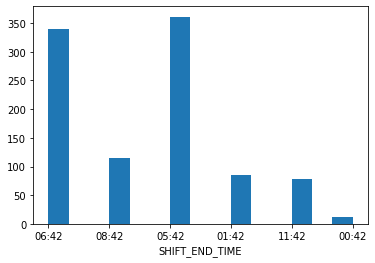

In [32]:
plt.hist(data_2['SHIFT_END_TIME'],bins=15)
plt.xlabel("SHIFT_END_TIME")

Text(0.5, 0, 'DE_ZONE_ID')

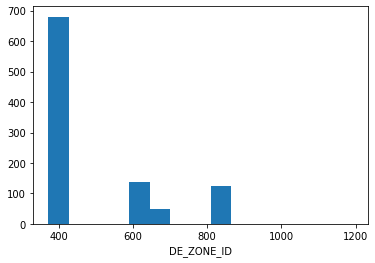

In [33]:
plt.hist(data_2['DE_ZONE_ID'],bins=15)
plt.xlabel("DE_ZONE_ID")

Text(0.5, 0, 'DE_JOINING_DATE')

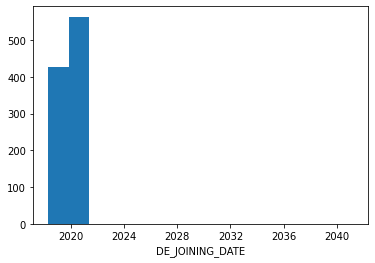

In [34]:
plt.hist(data_2['DE_JOINING_DATE'],bins=15)
plt.xlabel("DE_JOINING_DATE")

Text(0, 0.5, 'DE_JOINING_DATE')

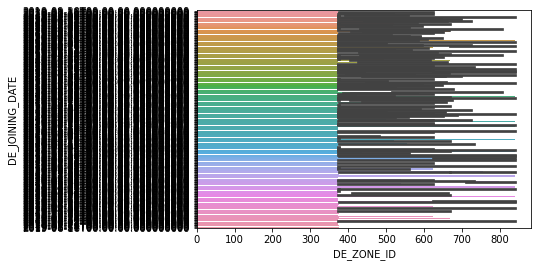

In [35]:
sns.barplot(data_2['DE_ZONE_ID'],data_2['DE_JOINING_DATE'])
plt.xlabel("DE_ZONE_ID")
plt.ylabel("DE_JOINING_DATE")

Text(0, 0.5, 'SHIFT_END_TIME')

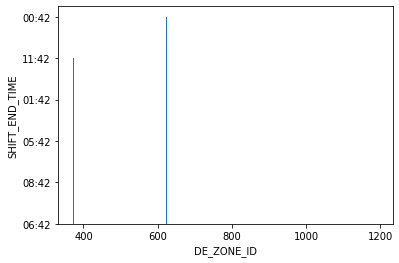

In [36]:
plt.bar(data_2['DE_ZONE_ID'],data_2['SHIFT_END_TIME'])
plt.xlabel("DE_ZONE_ID")
plt.ylabel("SHIFT_END_TIME")

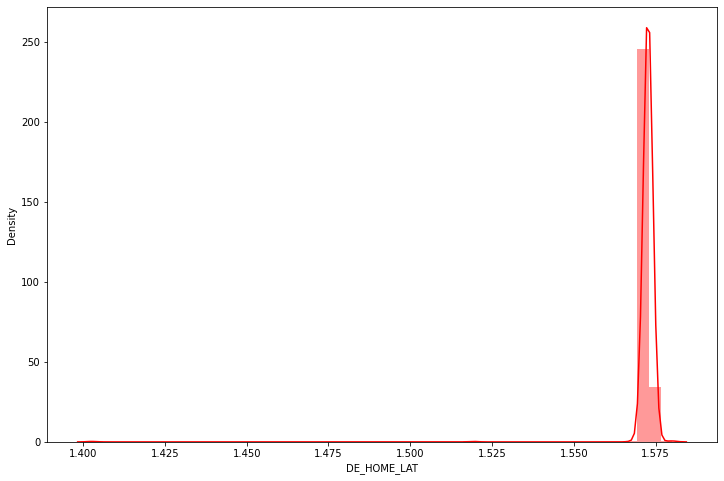

In [37]:
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(np.log10(data_2['DE_HOME_LAT']), kde = True, color = 'r' )

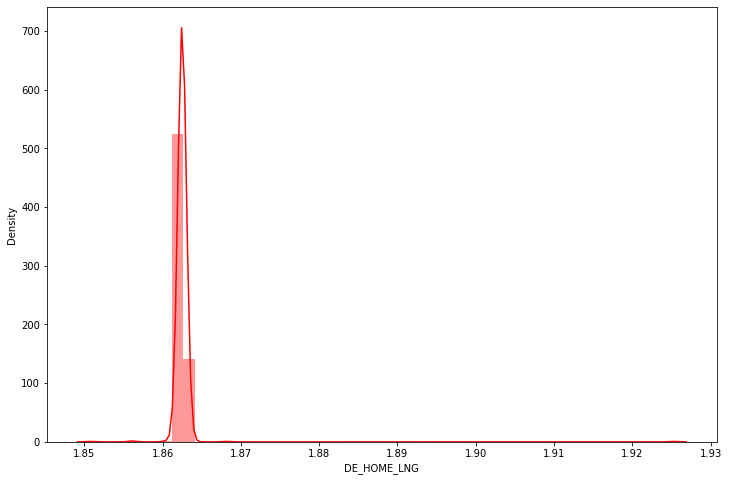

In [38]:
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(np.log10(data_2['DE_HOME_LNG']), kde = True, color = 'r' )

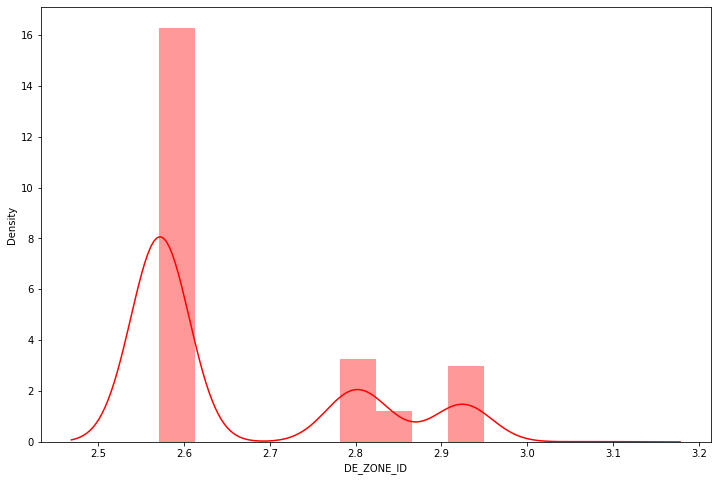

In [39]:
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(np.log10(data_2['DE_ZONE_ID']), kde = True, color = 'r' )

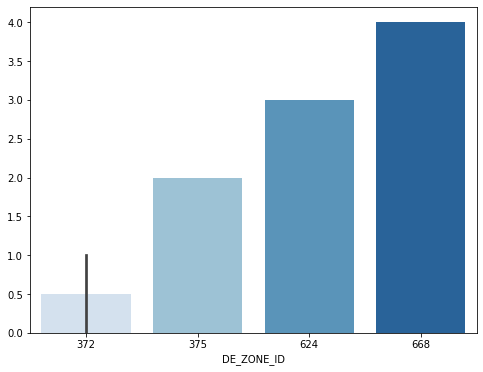

In [40]:
charges = data_2['DE_ZONE_ID'].groupby(data_2.DE_HOME_LAT).sum().sort_values(ascending = True)
f, ax = plt.subplots(1, 1, figsize=(8, 6))
ax = sns.barplot(data_2['DE_ZONE_ID'].head(), data_2['DE_ZONE_ID'].head().index, palette='Blues')

In [43]:
data_merge = pd.merge(data_1, data_2)
data_merge.describe()

,ORDER_ID,DE_ID,reject_ind,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
count,132394.000000,1.323940e+05,132394.000000,132384.000000,132238.000000,132394.000000,132391.000000,132394.000000,113853.000000,132394.000000,132394.000000,132394.000000,132394.000000,132394.000000
mean,62266.261303,6.156389e+05,0.060788,432.864177,364.857121,403.579538,2764.807124,24.165408,489.926537,37.389104,72.859044,37.375983,72.882069,484.022040
std,36083.677703,3.801389e+05,0.238942,82.305359,40.211260,53.905507,1277.496520,17.674050,171.226181,0.023136,0.032406,0.258701,0.491812,173.045174
min,1.000000,2.200000e+02,0.000000,320.000000,320.000000,250.000000,0.000000,1.000000,372.000000,37.271775,72.703223,25.268688,70.910224,372.000000
25%,30948.250000,3.338200e+05,0.000000,373.400000,327.500000,361.500000,2110.000000,11.000000,373.000000,37.371754,72.837974,37.368926,72.841093,372.000000
50%,62166.500000,3.862560e+05,0.000000,415.400000,356.600000,399.500000,2610.000000,20.000000,375.000000,37.387886,72.856902,37.384657,72.859931,374.000000
75%,93589.750000,9.462630e+05,0.000000,473.900000,392.600000,440.800000,3260.000000,32.000000,624.000000,37.407065,72.878175,37.405834,72.880463,624.000000
max,124798.000000,1.376302e+06,1.000000,1044.500000,743.000000,642.300000,10410.000000,120.000000,841.000000,37.483737,73.029503,38.031204,84.199659,1192.000000


In [44]:
data_merge.columns

Index(['ORDER_ID', 'DE_ID', 'ASSIGNMENT_START_TIME', 'ASSIGNMENT_END_TIME',
       'reject_ind', 'reject_type', 'PLACED_TIME', 'DELIVERED_TIME',
       'LASTMILE_DISTANCE', 'FIRSTMILE_DISTANCE', 'LAST_MILE_TIME_PREDICTED',
       'PAYOUT_MADE_TO_DE', 'NUM_PING_COUNT_LAST10MIN',
       'LAST_PING_TIME_LAST10MIN', 'CUSTOMER_ZONE', 'CUSTOMER_LAT',
       'CUSTOMER_LNG', 'SHIFT_END_TIME', 'DE_HOME_LAT', 'DE_HOME_LNG',
       'DE_JOINING_DATE', 'DE_ZONE_ID'],
      dtype='object')

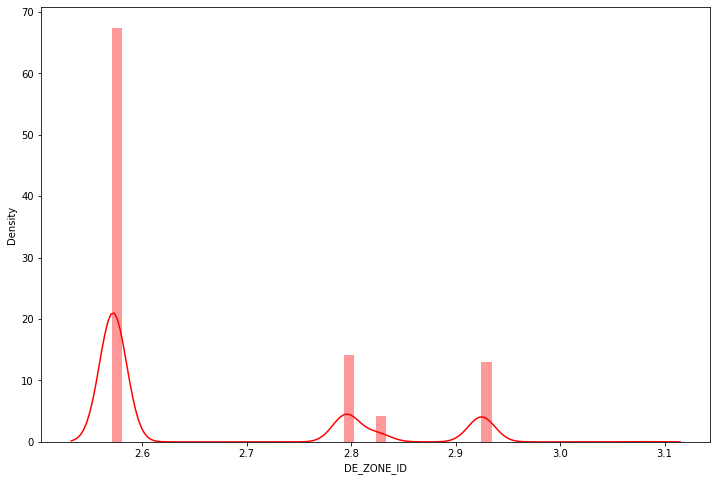

In [45]:
f, ax = plt.subplots(1, 1, figsize=(12, 8))
ax = sns.distplot(np.log10(data_merge['DE_ZONE_ID']), kde = True, color = 'r' )

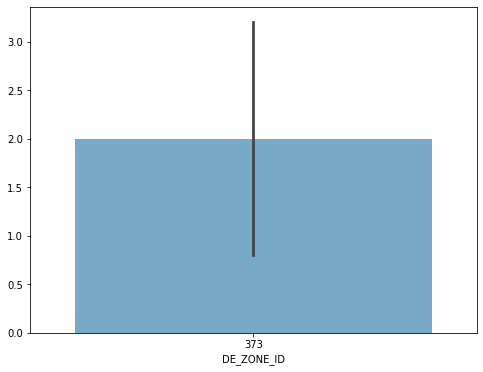

In [46]:
charges = data_merge['DE_ZONE_ID'].groupby(data_merge.DE_HOME_LAT).sum().sort_values(ascending = True)
f, ax = plt.subplots(1, 1, figsize=(8, 6))
ax = sns.barplot(data_merge['DE_ZONE_ID'].head(), data_merge['DE_ZONE_ID'].head().index, palette='Blues')

In [47]:
data_merge.corr()

,ORDER_ID,DE_ID,reject_ind,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
ORDER_ID,1.000000,-0.016869,-0.017058,0.011141,-0.079486,-0.000152,-0.025432,-0.059308,0.001052,-0.003743,-0.002170,-0.008342,0.003571,0.004439
DE_ID,-0.016869,1.000000,-0.007391,-0.010665,0.006290,-0.015819,-0.005748,0.029837,-0.028623,0.011692,-0.035284,-0.038335,0.061400,-0.060831
reject_ind,-0.017058,-0.007391,1.000000,0.066106,0.130705,0.069175,-0.550605,-0.058436,0.021851,0.028723,0.027208,-0.039232,0.029046,0.014304
LASTMILE_DISTANCE,0.011141,-0.010665,0.066106,1.000000,0.141466,0.812702,0.647351,-0.062587,0.104758,0.049430,0.082698,-0.005099,-0.005147,0.067917
FIRSTMILE_DISTANCE,-0.079486,0.006290,0.130705,0.141466,1.000000,0.128525,0.173946,0.116976,0.015280,0.041932,0.009580,-0.010040,0.013511,0.025178
LAST_MILE_TIME_PREDICTED,-0.000152,-0.015819,0.069175,0.812702,0.128525,1.000000,0.475771,-0.066378,0.145752,0.035625,0.084190,-0.005620,-0.000436,0.126952
PAYOUT_MADE_TO_DE,-0.025432,-0.005748,-0.550605,0.647351,0.173946,0.475771,1.000000,0.020726,0.044204,0.025835,0.045148,0.023513,-0.019029,0.031347
NUM_PING_COUNT_LAST10MIN,-0.059308,0.029837,-0.058436,-0.062587,0.116976,-0.066378,0.020726,1.000000,-0.036721,0.009574,-0.037717,0.015776,-0.011698,-0.028229
CUSTOMER_ZONE,0.001052,-0.028623,0.021851,0.104758,0.015280,0.145752,0.044204,-0.036721,1.000000,-0.009426,0.739334,0.017648,0.002795,0.513834
CUSTOMER_LAT,-0.003743,0.011692,0.028723,0.049430,0.041932,0.035625,0.025835,0.009574,-0.009426,1.000000,0.087447,0.008926,0.033181,0.066114


In [48]:
mask = np.zeros_like(data_merge.corr())
triangle_indices = np.triu_indices_from(mask)
mask[triangle_indices] = True
mask

array([[1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1., 1.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 1.]])

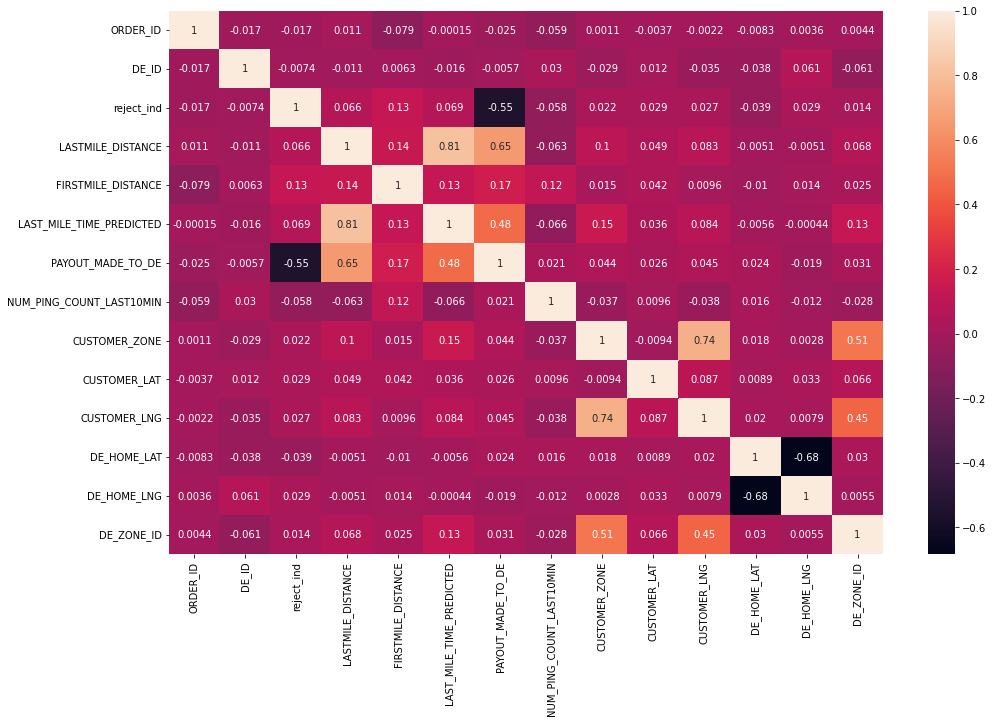

In [50]:
plt.figure(figsize=(16,10))
sns.heatmap(data_merge.corr(), annot=True)

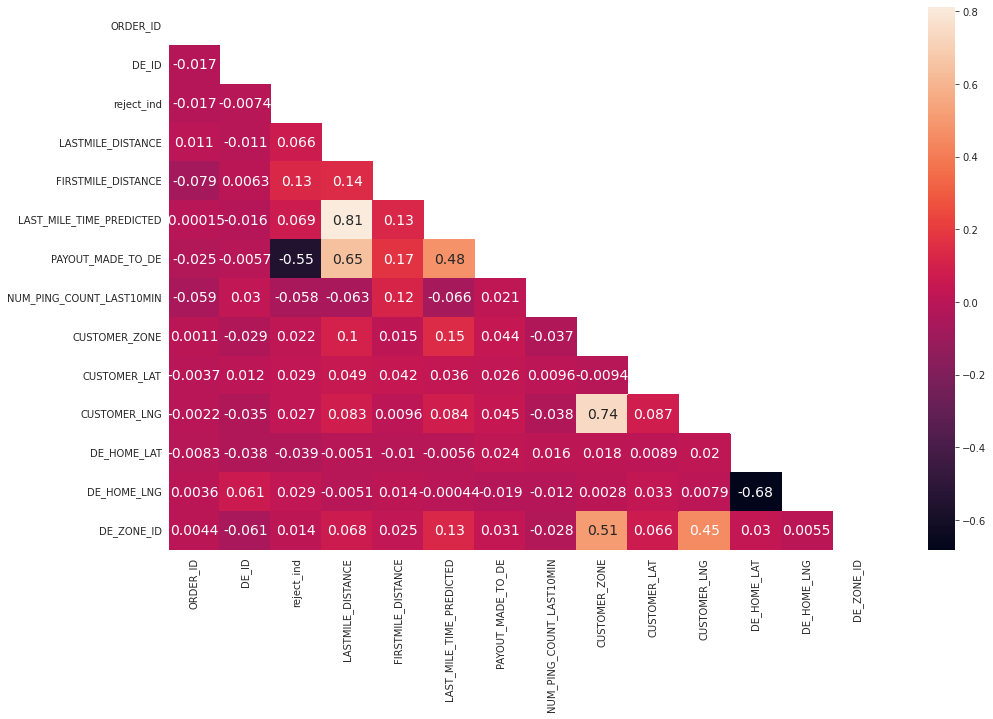

In [51]:
plt.figure(figsize=(16,10))
sns.set_style('white')
sns.heatmap(data_merge.corr(), mask=mask, annot=True, annot_kws={"size":14})

In [54]:
data_merge = data_merge.drop(['ASSIGNMENT_START_TIME'],axis=1)
data_merge = data_merge.drop(['ASSIGNMENT_END_TIME'],axis=1)
data_merge.head()

,ORDER_ID,DE_ID,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,LAST_PING_TIME_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,SHIFT_END_TIME,DE_HOME_LAT,DE_HOME_LNG,DE_JOINING_DATE,DE_ZONE_ID
0,2745,180976,0,NaN,2021-02-13 03:01:11.686,2021-02-13 03:43:26.000,320.9,320.0,314.0,1810.0,63,2021-02-13 03:07:34.000,373.0,37.377569,72.832560,05:42,37.374634,72.871986,2019-10-25,373
1,14974,180976,0,NaN,2021-02-15 03:30:24.093,2021-02-15 03:59:31.000,370.4,414.5,378.2,3710.0,52,2021-02-15 03:36:19.000,373.0,37.368782,72.809458,05:42,37.374634,72.871986,2019-10-25,373
2,115325,180976,0,NaN,2021-03-04 04:47:34.977,2021-03-04 05:28:19.000,408.2,320.0,397.2,2760.0,9,2021-03-04 04:56:33.000,373.0,37.374205,72.827956,05:42,37.374634,72.871986,2019-10-25,373
3,1648,180976,0,NaN,2021-02-13 00:11:09.582,2021-02-13 01:07:36.000,389.6,342.8,382.5,2210.0,16,2021-02-13 00:12:27.000,373.0,37.369154,72.815318,05:42,37.374634,72.871986,2019-10-25,373
4,72496,180976,0,NaN,2021-02-25 03:56:48.521,2021-02-25 04:35:31.000,392.3,418.1,351.3,2460.0,13,2021-02-25 04:07:58.000,373.0,37.376896,72.834044,05:42,37.374634,72.871986,2019-10-25,373


In [55]:
data_merge = data_merge.drop(['LAST_PING_TIME_LAST10MIN'],axis=1)
data_merge.head()

,ORDER_ID,DE_ID,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,SHIFT_END_TIME,DE_HOME_LAT,DE_HOME_LNG,DE_JOINING_DATE,DE_ZONE_ID
0,2745,180976,0,NaN,2021-02-13 03:01:11.686,2021-02-13 03:43:26.000,320.9,320.0,314.0,1810.0,63,373.0,37.377569,72.832560,05:42,37.374634,72.871986,2019-10-25,373
1,14974,180976,0,NaN,2021-02-15 03:30:24.093,2021-02-15 03:59:31.000,370.4,414.5,378.2,3710.0,52,373.0,37.368782,72.809458,05:42,37.374634,72.871986,2019-10-25,373
2,115325,180976,0,NaN,2021-03-04 04:47:34.977,2021-03-04 05:28:19.000,408.2,320.0,397.2,2760.0,9,373.0,37.374205,72.827956,05:42,37.374634,72.871986,2019-10-25,373
3,1648,180976,0,NaN,2021-02-13 00:11:09.582,2021-02-13 01:07:36.000,389.6,342.8,382.5,2210.0,16,373.0,37.369154,72.815318,05:42,37.374634,72.871986,2019-10-25,373
4,72496,180976,0,NaN,2021-02-25 03:56:48.521,2021-02-25 04:35:31.000,392.3,418.1,351.3,2460.0,13,373.0,37.376896,72.834044,05:42,37.374634,72.871986,2019-10-25,373


In [56]:
data_merge = data_merge.drop(['SHIFT_END_TIME'],axis=1)
data_merge = data_merge.drop(['DE_JOINING_DATE'],axis=1)
data_merge.head()

,ORDER_ID,DE_ID,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
0,2745,180976,0,NaN,2021-02-13 03:01:11.686,2021-02-13 03:43:26.000,320.9,320.0,314.0,1810.0,63,373.0,37.377569,72.832560,37.374634,72.871986,373
1,14974,180976,0,NaN,2021-02-15 03:30:24.093,2021-02-15 03:59:31.000,370.4,414.5,378.2,3710.0,52,373.0,37.368782,72.809458,37.374634,72.871986,373
2,115325,180976,0,NaN,2021-03-04 04:47:34.977,2021-03-04 05:28:19.000,408.2,320.0,397.2,2760.0,9,373.0,37.374205,72.827956,37.374634,72.871986,373
3,1648,180976,0,NaN,2021-02-13 00:11:09.582,2021-02-13 01:07:36.000,389.6,342.8,382.5,2210.0,16,373.0,37.369154,72.815318,37.374634,72.871986,373
4,72496,180976,0,NaN,2021-02-25 03:56:48.521,2021-02-25 04:35:31.000,392.3,418.1,351.3,2460.0,13,373.0,37.376896,72.834044,37.374634,72.871986,373


In [57]:
x = data_merge.drop(['reject_ind'],axis=1)
y = data_1['reject_ind']
x.shape,y.shape

((132394, 16), (132394,))

In [60]:
from sklearn.utils import shuffle
data_merge = shuffle(data_merge,random_state=42)
data_merge.head()

,ORDER_ID,DE_ID,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
78431,85847,377132,0,NaN,2021-02-27 04:09:48.709,2021-02-27 04:52:01.000,414.8,320.0,410.3,1810.0,48,374.0,37.362211,72.871346,37.358917,72.901167,841
91388,52532,258097,0,NaN,2021-02-21 22:14:49.814,2021-02-21 22:46:10.000,471.2,334.1,410.5,3060.0,8,NaN,37.348522,72.829390,37.380721,72.849771,372
102151,68581,246983,0,NaN,2021-02-24 19:09:58.335,2021-02-24 19:30:05.000,350.3,385.7,361.0,2010.0,9,624.0,37.412720,72.882788,37.420702,72.876488,624
124823,91707,281239,0,NaN,2021-02-28 03:27:26.437,2021-02-28 04:10:51.000,566.3,377.0,500.2,4560.0,50,668.0,37.409165,72.898487,37.386745,72.848642,372
131187,7810,288344,1,Type-3,2021-02-14 02:36:05.554,2021-02-14 03:58:19.000,566.6,429.2,513.8,0.0,42,624.0,37.429223,72.862592,37.382501,72.858649,841


In [61]:
from sklearn.model_selection import train_test_split
train_x,test_x,train_y,test_y=train_test_split(x,y,random_state=56,stratify=y)
train_x.shape,test_x.shape,train_y.shape,test_y.shape

((99295, 16), (33099, 16), (99295,), (33099,))

In [62]:
train_x.head()

,ORDER_ID,DE_ID,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
102590,16344,695623,NaN,2021-02-15 05:07:33.269,2021-02-15 05:43:15.000,370.7,320.0,327.7,2560.0,21,841.0,37.384502,72.885879,37.361045,72.895660,841
59981,13250,877164,NaN,2021-02-15 00:17:47.489,2021-02-15 01:11:57.000,449.0,339.5,396.5,2510.0,41,375.0,37.412892,72.851935,37.389604,72.849194,375
5562,56076,1249476,NaN,2021-02-22 05:07:00.611,2021-02-22 05:24:04.000,470.3,374.6,421.8,2760.0,32,373.0,37.372387,72.811883,37.382760,72.873082,372
42535,37064,825993,NaN,2021-02-19 01:50:13.221,2021-02-19 02:31:48.000,418.1,454.7,398.0,2960.0,14,NaN,37.346050,72.865041,37.371018,72.849014,374
77764,10680,374066,NaN,2021-02-14 10:37:31.158,2021-02-14 11:09:32.000,533.6,341.6,436.2,4860.0,8,841.0,37.381251,72.878203,37.358391,72.864172,374


In [63]:
data_merge = data_merge.dropna()
data_merge.head()

,ORDER_ID,DE_ID,reject_ind,reject_type,PLACED_TIME,DELIVERED_TIME,LASTMILE_DISTANCE,FIRSTMILE_DISTANCE,LAST_MILE_TIME_PREDICTED,PAYOUT_MADE_TO_DE,NUM_PING_COUNT_LAST10MIN,CUSTOMER_ZONE,CUSTOMER_LAT,CUSTOMER_LNG,DE_HOME_LAT,DE_HOME_LNG,DE_ZONE_ID
131187,7810,288344,1,Type-3,2021-02-14 02:36:05.554,2021-02-14 03:58:19.000,566.6,429.2,513.8,0.0,42,624.0,37.429223,72.862592,37.382501,72.858649,841
62350,104353,259417,1,Type-1,2021-03-02 06:41:09.132,2021-03-02 07:06:10.000,360.2,324.8,360.2,0.0,23,374.0,37.369183,72.853852,37.355523,72.903672,374
31319,73685,371050,1,Type-2,2021-02-25 05:09:07.109,2021-02-25 05:48:00.000,408.2,431.9,358.7,0.0,69,375.0,37.405581,72.839164,37.413697,72.883626,372
67285,77786,975935,1,Type-1,2021-02-26 00:47:44.044,2021-02-26 02:02:58.000,504.8,363.8,443.3,0.0,22,372.0,37.385957,72.861770,37.390315,72.898621,372
58528,104712,235954,1,Type-3,2021-03-02 11:09:52.686,2021-03-02 11:55:59.000,516.2,449.0,467.8,0.0,39,375.0,37.398401,72.818250,37.382046,72.856882,372


# Model Training

In [92]:
df_assign = pd.read_csv("Assignment_Data.csv")
df_partner = pd.read_csv("Delivery_Partners_Data.csv")
df_partner = df_partner.drop(['DE_JOINING_DATE'],axis=1)

In [95]:
df_final = df_assign.merge(df_partner, on="DE_ID", how = 'inner')
target = df_final['reject_ind']
df_final = df_final.drop(['reject_ind'],axis=1)
df_final['LASTMILE_DISTANCE'].fillna(value=df_final['LASTMILE_DISTANCE'].mean(), inplace=True)
df_final['FIRSTMILE_DISTANCE'].fillna(value=df_final['FIRSTMILE_DISTANCE'].mean(), inplace=True)

from math import radians, cos, sin, asin, sqrt
def dist(lat1, long1, lat2, long2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # convert decimal degrees to radians 
    lat1, long1, lat2, long2 = map(radians, [lat1, long1, lat2, long2])
    # haversine formula 
    dlon = long2 - long1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    # Radius of earth in kilometers is 6371
    km = 6371* c
    return km

for ind,row in df_final.iterrows():
  lat1=row['CUSTOMER_LAT']
  long1=row['CUSTOMER_LNG']
  lat2=row['DE_HOME_LAT']
  long2=row['DE_HOME_LNG']
  df_final['distance'] = dist(lat1,long1,lat2,long2)

df_final_new = df_final.drop(['DE_HOME_LAT','DE_HOME_LNG','CUSTOMER_LAT','CUSTOMER_LNG','CUSTOMER_ZONE','DE_ZONE_ID','DELIVERED_TIME'],axis=1)
df_final_new['ASSIGNMENT_START_TIME'] = pd.to_datetime(df_final_new['ASSIGNMENT_START_TIME'])
df_final_new['ASSIGNMENT_START_TIME_hour'] = df_final_new['ASSIGNMENT_START_TIME'].dt.hour
df_final_new['ASSIGNMENT_START_TIME_min'] = df_final_new['ASSIGNMENT_START_TIME'].dt.minute
df_final_new = df_final_new.drop(['ASSIGNMENT_START_TIME'],axis=1)
df_final_new = df_final_new.drop(['ORDER_ID','DE_ID','reject_type'],axis=1)
df_final_new['ASSIGNMENT_END_TIME'] = pd.to_datetime(df_final_new['ASSIGNMENT_END_TIME'])
df_final_new['ASSIGNMENT_END_TIME_hour'] = df_final_new['ASSIGNMENT_END_TIME'].dt.hour
df_final_new['ASSIGNMENT_END_TIME_min'] = df_final_new['ASSIGNMENT_END_TIME'].dt.minute
df_final_new = df_final_new.drop(['ASSIGNMENT_END_TIME'],axis=1)
df_final_new['PLACED_TIME'] = pd.to_datetime(df_final_new['PLACED_TIME'])
df_final_new['PLACED_TIME_hour'] = df_final_new['PLACED_TIME'].dt.hour
df_final_new['PLACED_TIME_min'] = df_final_new['PLACED_TIME'].dt.minute
df_final_new = df_final_new.drop(['PLACED_TIME'],axis=1)
df_final_new['LAST_PING_TIME_LAST10MIN'] = pd.to_datetime(df_final_new['LAST_PING_TIME_LAST10MIN'])
df_final_new['LAST_PING_TIME_LAST10MIN_hour'] = df_final_new['LAST_PING_TIME_LAST10MIN'].dt.hour
df_final_new['LAST_PING_TIME_LAST10MIN_min'] = df_final_new['LAST_PING_TIME_LAST10MIN'].dt.minute
df_final_new = df_final_new.drop(['LAST_PING_TIME_LAST10MIN'],axis=1)

import time
for ind,row in df_final.iterrows():
  df_final_new['SHIFT_END_TIME_hour'] = time.strptime(row['SHIFT_END_TIME'],"%H:%M").tm_hour
  df_final_new['SHIFT_END_TIME_min'] = time.strptime(row['SHIFT_END_TIME'],"%H:%M").tm_min

df_final_new['SHIFT_END_TIME_hour'] = pd.to_datetime(df_final_new['SHIFT_END_TIME'], format='%H:%M').dt.hour
df_final_new['SHIFT_END_TIME_min'] = pd.to_datetime(df_final_new['SHIFT_END_TIME'], format='%H:%M').dt.minute
df_final_new = df_final_new.drop(['SHIFT_END_TIME'],axis = 1)
df_final_new['PAYOUT_MADE_TO_DE'].fillna(value = df_final_new['PAYOUT_MADE_TO_DE'].mean(), inplace = True)

In [96]:
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics
X_train, X_test, y_train, y_test = train_test_split(df_final_new,target, test_size=0.35, random_state=1) 

In [97]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)

(86056, 16)
(86056,)
(46338, 16)


## Decision Forest Classifier

In [98]:
clf = DecisionTreeClassifier(criterion = "entropy", max_depth=3)
# Train Decision Tree Classifer
clf = clf.fit(X_train,y_train)
#Predict the response for test dataset
y_pred = clf.predict(X_test)
# Model Accuracy, how often is the classifier correct?
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))

Accuracy: 1.0


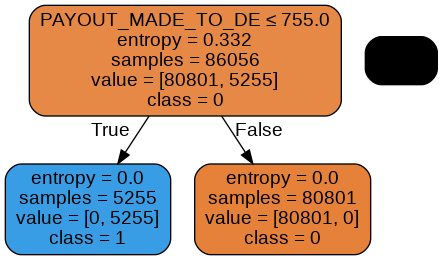

In [100]:
from six import StringIO
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(clf, out_file = dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = df_final_new.columns,class_names = ['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

## Random Forest Classifier

In [102]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.feature_selection import SelectFromModel
#Create a Gaussian Classifier
sel = SelectFromModel(RandomForestClassifier(n_estimators = 100))
sel.fit(X_train, y_train)
#Train the model using the training sets 
y_pred = clf.predict(X_test)
sel.get_support()

array([False, False, False,  True, False, False, False, False, False,
       False, False, False, False, False, False, False])

In [103]:
selected_feat = X_train.columns[(sel.get_support())]
selected_feat

Index(['PAYOUT_MADE_TO_DE'], dtype='object')

In [104]:
df_pay = pd.DataFrame(df_final_new['PAYOUT_MADE_TO_DE'])
df_pay.head()

,PAYOUT_MADE_TO_DE
0,1810.0
1,3710.0
2,2760.0
3,2210.0
4,2460.0


In [105]:
X_train_pay, X_test_pay, y_train_pay, y_test_pay = train_test_split(df_pay,target, test_size=0.30, random_state=1) 

In [106]:
from sklearn.preprocessing import MinMaxScaler
# fit scaler on training data
norm_pay = MinMaxScaler().fit(X_train_pay)
# transform training data
X_train_norm_pay = norm_pay.transform(X_train_pay)
# transform testing dataabs
X_test_norm_pay = norm_pay.transform(X_test_pay)

## SVM Classifier

In [107]:
from sklearn import svm
#Create a svm Classifier
clf_svm_pay = svm.SVC(kernel='linear') # Linear Kernel
#Train the model using the training sets
clf_svm_pay.fit(X_train_norm_pay, y_train_pay)
#Predict the response for test dataset
y_pred_pay = clf_svm_pay.predict(X_test_norm_pay)
# Model Accuracy: how often is the classifier correct?
print("Accuracy:",metrics.accuracy_score(y_test_pay, y_pred_pay))

Accuracy: 1.0


In [108]:
clf.fit(X_train,y_train)
y_pred = clf.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_pred))

Accuracy: 1.0


## XGBoost

In [109]:
from sklearn.preprocessing import MinMaxScaler
# fit scaler on training data
norm = MinMaxScaler().fit(X_train)
# transform training data
X_train_norm = norm.transform(X_train)
# transform testing dataabs
X_test_norm = norm.transform(X_test)

In [110]:
from numpy import loadtxt
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score
# fit model no training data
model_xg = XGBClassifier()
model_xg.fit(X_train_norm, y_train)
# make predictions for test data
y_pred_xg = model_xg.predict(X_test_norm)
predictions_xg = [round(value) for value in y_pred_xg]
# evaluate predictions
accuracy = accuracy_score(y_test, predictions_xg)
print("Accuracy: %.2f%%" % (accuracy * 100.0))

Accuracy: 100.00%
